In [1]:
#%%
import SOAPify
from SOAPify import trackStates
import hdbscan
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
import numpy
import h5py
import seaborn as sns
import scipy.ndimage
from HDF5er import getXYZfromTrajGroup
# pip install -U hdbscan scipy h5py numpy matplotlib seaborn
#%%

/home/matteo/envs/production/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/matteo/envs/production/lib/python3.9/site-packages/MDAnalysis/coordinates/TRJ.py:1209: DeprecationWarning: Please use `netcdf_file` from the `scipy.io` namespace, the `scipy.io.netcdf` namespace is deprecated.
  class NCDFPicklable(scipy.io.netcdf.netcdf_file):


In [2]:
with h5py.File("./210.hdf5", "r") as inputPamm:
    mask = inputPamm["Trajectories/210_T_500/Trajectory"][0, :, 2] > -1
    thedata = inputPamm["PCAs/test210_redux/210_T_500"][250:][:, mask, :].reshape(-1, 3)

with h5py.File("./210.hdf5", "r") as inputPamm:
    mask = inputPamm["Trajectories/210_T_500/Trajectory"][0, :, 2] > -1
    data_tot = inputPamm["PCAs/test210_redux/210_T_500"][:][:, mask, :].reshape(-1, 3)
    
    
    
def getRanges(interval):
    return (interval[:-1] + interval[1:]) / 2


def getDensity(data, PCX, PCY, bins, sigma=1):
    h, xe, ye = numpy.histogram2d(data[:, PCX], data[:, PCY], bins=bins, density=True)
    lh = numpy.log(h)
    lhmax = numpy.max((lh))
    lh -= lhmax
    lhmin = numpy.min((lh[lh != -numpy.inf]))
    lh[lh == -numpy.inf] = lhmin
    scipy.ndimage.gaussian_filter(lh, sigma=sigma, order=0, output=lh)
    X = getRanges(xe)
    Y = getRanges(ye)
    return lh.T, X, Y, lhmin


#%%


def figplot(data, skip, clusters, cluster_colors, nclusters, csm, fname):

    fig = plt.figure(figsize=(30, 10), dpi=200)
    for i, (X, Y) in enumerate([(0, 1), (0, 2), (1, 2)]):
        ax = fig.add_subplot(1, 3, i + 1)
        s = ax.scatter(
            data[::skip, X],
            data[::skip, Y],
            c=cluster_colors,
            s=1,
            alpha=0.1,
        )
        lh, Xe, Ye, lhmin = getDensity(data, X, Y, 200)
        levels = 8
        cont = ax.contour(
            Xe,
            Ye,
            lh,
            colors="k",
            linewidths=0.5,
            levels=levels,
            antialiased=True,
            linestyles="solid",
            vmin=lhmin,
            vmax=0,
        )
        if i == 0:
            ax.set_title(
                # f"PC{X+1},PC{Y+1}, xi=-{xi:.3f}, min_samples={min_samples}, ncluster={len(set(db))}"
                f"PC{X+1},PC{Y+1}, ncluster={nclusters} cluster_selection_method={csm}"
            )

        else:
            ax.set_title(f"PC{X+1},PC{Y+1}")
    # cax = fig.add_axes([0.27, 0.1, 0.5, 0.05])
    # fig.colorbar(s, cax=cax, orientation="horizontal")
    fig.savefig(
        f"{fname}.png",
        transparent=False,
        edgecolor="w",
        facecolor="w",
        dpi=200,
        bbox_inches="tight",
    )
    numpy.savetxt(
        f"{fname}.txt",
        clusters,
        fmt="%d",
    )


def printClustersAndNoise(data, skip, fname, color_palette, clusterer, csm, nclusters):
    cluster_colors = [
        # color_palette[x] if x >= 0 else (0.5, 0.5, 0.5) for x in clusterer.labels_
        color_palette[x] if x >= 0 else (0.9, 0.9, 0.9)
        for x in clusterer.labels_
    ]
    cluster_member_colors = [
        sns.desaturate(x, p) for x, p in zip(cluster_colors, clusterer.probabilities_)
    ]
    figplot(data, skip, clusterer.labels_, cluster_member_colors, nclusters, csm, fname)
    return clusterer.labels_


def printClusterPrediction(data, skip, fname, color_palette, clusterer, csm, nclusters):
    soft_clusters = hdbscan.all_points_membership_vectors(clusterer)
    soft_clusters = numpy.argmax(soft_clusters, axis=1)
    cluster_colors = [color_palette[x] for x in soft_clusters]
    figplot(data, skip, soft_clusters, cluster_colors, nclusters, csm, fname)
    return soft_clusters


def printClusterPredictionOnNoise(
    data, skip, fname, color_palette, clusterer, csm, nclusters
):
    clusters = clusterer.labels_.copy()
    cluster_colors = [color_palette[x] for x in clusters]
    soft_clusters = hdbscan.all_points_membership_vectors(clusterer)
    for i in range(len(clusters)):
        if clusters[i] < 0:
            clusters[i] = numpy.argmax(soft_clusters[i])
            cluster_colors[i] = sns.desaturate(color_palette[clusters[i]], 0.5)
    figplot(data, skip, clusters, cluster_colors, nclusters, csm, fname)
    return clusters


def useAllHDBSCANS(data, skip=10, min_cluster_size=300, directory="./",min_samples=None):
    # for xi in numpy.arange(0.05, 0.5, 0.05):
    # for min_samples in [3, 4, 5, 6, 7, 8]:
    for csm in ["eom", "leaf"]:
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size,
            min_samples=min_samples,
            cluster_selection_method=csm,
            prediction_data=True,
        )
        clusterer.fit(data[::skip])
        nclusters = clusterer.labels_.max() + 1
        print(f"{csm}: {nclusters}")
        color_palette = sns.color_palette("colorblind", nclusters)  # , as_cmap=True)
        # Figure with clusters and grayed out noise
        wNoise = printClustersAndNoise(
            data,
            skip,
            f"{directory}/hdbscan-{csm}",
            color_palette,
            clusterer,
            csm,
            nclusters,
        )
        wPredict = printClusterPrediction(
            data,
            skip,
            f"{directory}/hdbscanPred-{csm}",
            color_palette,
            clusterer,
            csm,
            nclusters,
        )
        wPredictNoise = printClusterPredictionOnNoise(
            data,
            skip,
            f"{directory}/hdbscanPredNoise-{csm}",
            color_palette,
            clusterer,
            csm,
            nclusters,
        )
def useAllHDBSCANS_50ps(data, skip=10, min_cluster_size=300, directory="./",min_samples=None):
    # for xi in numpy.arange(0.05, 0.5, 0.05):
    # for min_samples in [3, 4, 5, 6, 7, 8]:
    for csm in ["eom"]:
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size,
            min_samples=min_samples,
            cluster_selection_method=csm,
            prediction_data=True,
        )
        clusterer.fit(data[::skip])
        nclusters = clusterer.labels_.max() + 1

In [3]:
def getCompactedAnnotationsForTmat_percent(tmat) -> list:
    """
    Returns a list of compacted annotations for a given tmat.
    """
    annot = list(numpy.empty(tmat.shape, dtype=str))
    # annot=numpy.chararray(tmat.shape, itemsize=5)
    for row in range(tmat.shape[0]):
        annot[row] = list(annot[row])
        for col in range(tmat.shape[1]):
            if tmat[row, col] < 0.01:
                annot[row][col] = f"<1"
            elif tmat[row, col] > 0.99:
                annot[row][col] = f">99"
            else:
                annot[row][col] = f"{100*tmat[row,col]:.0f}"
    return annot

In [4]:
import matplotlib.patches as patches

colors=['#cccccc','#00007f','#00ff7f','#aa0000']
def PLTmatrixrates_label_colors_perc(data, colors, axes):
    ax = axes
    fig, ax = plt.subplots(figsize=(10,10)) 
    sns.heatmap(pd.DataFrame(n1,index=new_names, columns=new_names), linewidths=0.1, ax=ax, fmt=".0f", 
                 square=True,cmap="rocket_r", mask=mask,vmax=230000, vmin=0, annot=True,cbar=False, linecolor='white', alpha=1., annot_kws={"fontsize":21})

    TICKYPOS = -0.3
    tickslabels = [i+0.5 for i in range(len(n1))]

    for i in range(len(n1)):
        ax.add_patch(patches.Circle((tickslabels[i],TICKYPOS), facecolor=colors[i], lw=1.5, edgecolor='black', radius=.2,
                           clip_on=False))
        ax.add_patch(patches.Circle((TICKYPOS,tickslabels[i]), facecolor=colors[i], lw=1.5, edgecolor='black', radius=.2,
                           clip_on=False))
        
    for _, spine in ax.spines.items():
        spine.set_visible(True)

    ax.get_xaxis().set_ticklabels([])
    ax.xaxis.tick_top()
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    return ax

eom: 4


/tmp/ipykernel_16097/1229629528.py:17: RuntimeWarning: divide by zero encountered in log
  lh = numpy.log(h)


leaf: 4


/tmp/ipykernel_16097/1229629528.py:17: RuntimeWarning: divide by zero encountered in log
  lh = numpy.log(h)


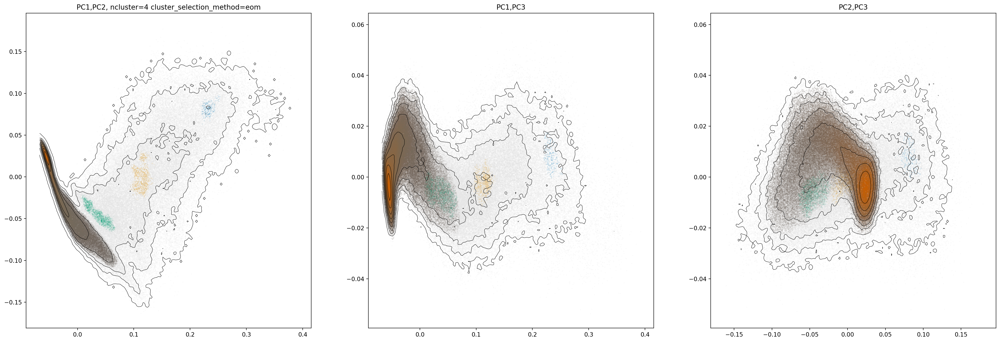

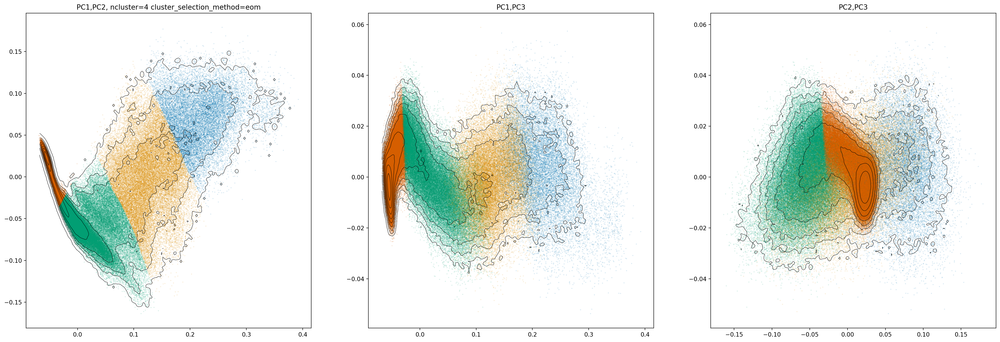

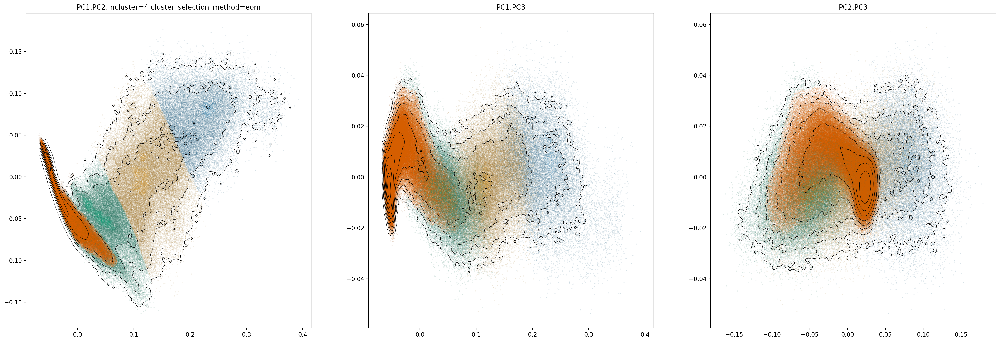

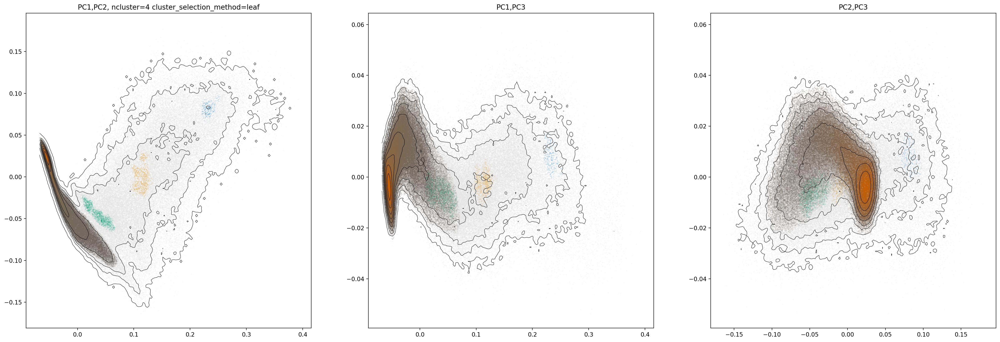

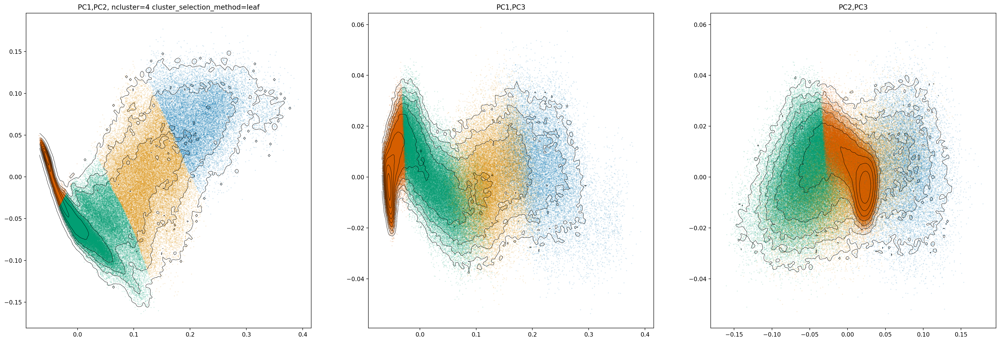

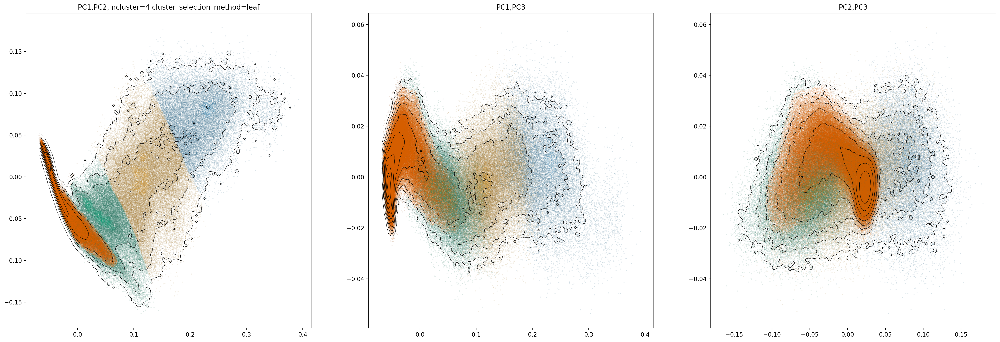

In [5]:
!mkdir -p hdbscan_final
useAllHDBSCANS(thedata, 1, 200, "./hdbscan_final")

In [6]:
a=numpy.loadtxt('./hdbscan_final/hdbscanPredNoise-eom.txt')
b=numpy.array(a,dtype=numpy.int32)
clusters_hdbs=b.reshape(-1,1248)
clusters_hdbs.shape
hdbs_300ps=clusters_hdbs[:]

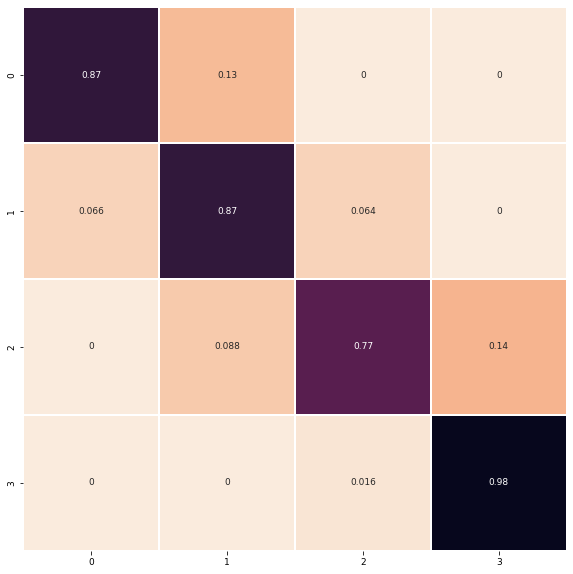

In [7]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from SOAPify import (SOAPclassification,
transitionMatrixFromSOAPClassificationNormalized as TransitionMatrixMaker,
transitionMatrixFromSOAPClassification as TransitionMatrixMakerNotNorm,
)
names=[str(i) for i in range(0,4)]
classification = SOAPclassification(
None, 
hdbs_300ps, 
names,
)
plt.rcParams.update({'font.size': 9})
matrix_cl=TransitionMatrixMaker(classification, 1)#[:-1,:-1] #[:-1,:-1] non considero ultima r e colonna
fig, ax = plt.subplots(figsize=(10,10)) 
ax = sns.heatmap(pd.DataFrame(matrix_cl,index=names, columns=names),linewidths=0.1,ax=ax, fmt=".2g", annot=True,
                 square=True,cmap="rocket_r", vmax=1, vmin=0,cbar=False, label=names)

In [ ]:
new_names=[3,2,0,1]
n1=matrix_cl[[ 3,2,0,1]][:,[ 3,2,0,1]]
plt.rcParams.update({'font.size': 25})
fig, ax = plt.subplots(figsize=(10,10),dpi=300) 
annot=getCompactedAnnotationsForTmat_percent(n1)
mask=n1==0
ax = sns.heatmap(pd.DataFrame(n1,index=new_names, columns=new_names),linewidths=0.2, ax=ax, fmt="s", square=True,cmap="rocket_r", mask=mask,vmax=1, vmin=0, annot=annot,cbar=False)

In [ ]:
links=sch.linkage(n1,method="complete")
dendro=sch.dendrogram(links,above_threshold_color='black',color_threshold=0,orientation='left',labels=new_names)

In [ ]:
PLTmatrixrates_label_colors_perc(n1, colors, ax)

In [ ]:
for csm in ["eom"]:
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=200,
            min_samples=None,
            cluster_selection_method=csm,
            prediction_data=True,
        )
        clusterer.fit(thedata)

In [ ]:
soft_clusters = hdbscan.prediction.membership_vector(clusterer, data_tot)
soft_clusters.shape

In [ ]:
test_labels=numpy.array([numpy.argmax(x)
                  for x in soft_clusters])
set(test_labels.flatten())

In [ ]:
cluster_tot=numpy.array(test_labels,dtype=numpy.int32)
numpy.savetxt('cluster_tot',cluster_tot)

In [ ]:
kind = "PredNoise"
for csm in ["eom"]:
    data = numpy.loadtxt(f"cluster_tot",dtype=('int32'))
    #data = numpy.loadtxt(f"./hdbscan_def/hdbscan{kind}-{csm}.txt",dtype=int,)
    print(set(data.flatten()))
    
    with h5py.File("./210.hdf5", "r") as inputPamm, open(
        f"210-500-hdbscan-0k.xyz", "w"
    ) as outfile:
       
        mask = inputPamm["Trajectories/210_T_500/Trajectory"][0, :, 2] > -1
        theShape = inputPamm["PCAs/test210_redux/210_T_500"][:][:, mask].shape
        #data = data.reshape(-1,1300)
        data = data.reshape(-1,1248)
        newData = numpy.ones((502, 2304)) * -2
        newData[:, mask] = data
        getXYZfromTrajGroup(
            outfile,
            inputPamm["Trajectories/210_T_500"],
            #framesToExport=[:],
            newData=newData,
        )